### CS/ECE/ISyE 524 &mdash; Introduction to Optimization &mdash; Spring 2023 ###

### Final Course Project: Due 5/5/23

# United States Federal Government Budget 2023 Optimization #

#### Prajjwal Gandharv (gandharv@wisc.edu)

*****

### Table of Contents

1. [Introduction](#1.-Introduction)
1. [Mathematical Model](#2.-Mathematical-model)
1. [Solution](#3.-Solution)
1. [Results and Discussion](#4.-Results-and-discussion)
  1. [Comparison of both models](#4.A.-Comparison-of-both-models)
  2. [Taxation and Expenditure Change analysis](#4.B.-Taxation-and-Expenditure-Change-analysis)
1. [Conclusion](#5.-Conclusion)

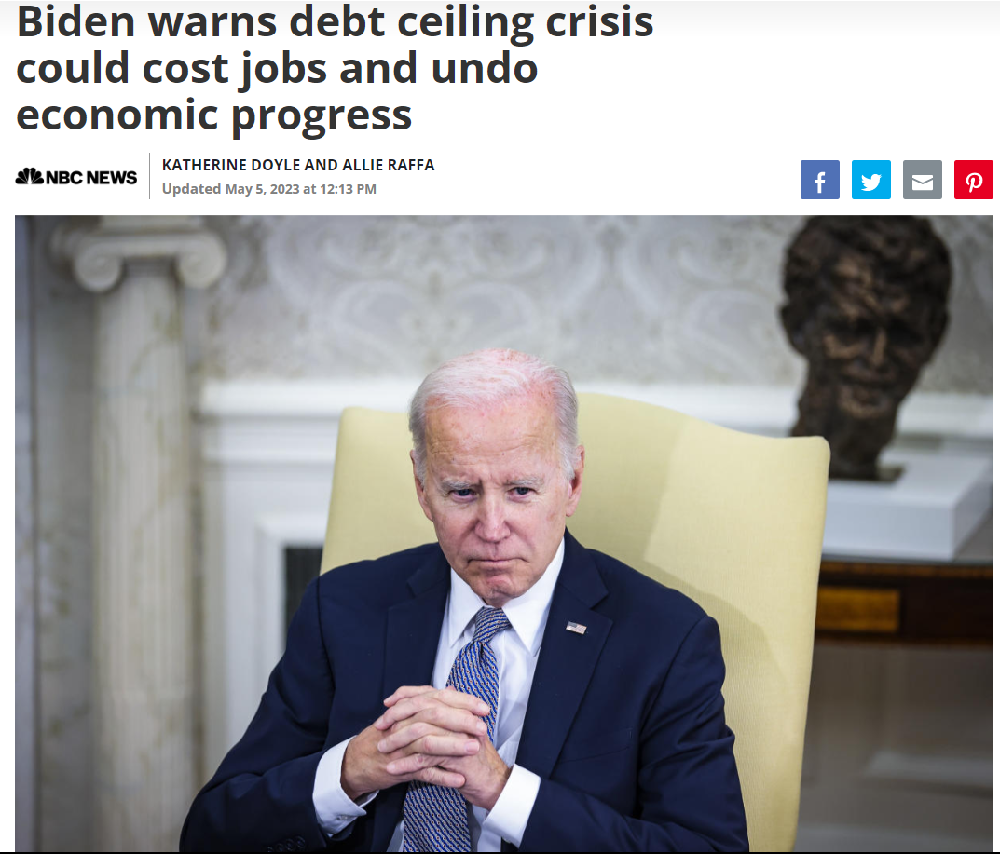

## 1. Introduction ##

The Covid-19 pandemic necessitated the need for excessive spending by the Federal Government to support the American Economy. The pandemic induced contraction in total economic output led to a fall in Tax collection from economic activity, but spending needs skyrocketed. Governments borrow money from the public to access funds that cover the difference between Tax collection and total spending. Before the pandemic, the total debt held by the federal government was at sustainable levels but since then, it has reached unsustainable levels. 

The total debt held by the Government has reached the limit set by Congress. The United States is already in the middle of a debt Crisis as lawmakers wrestle in Washington about the terms that would allow the government to borrow more money to pay it's bills, and they only have until May 31, 2023 to do so. If the Government defaults, the nation would plunge into an Economic crisis. Even if this crisis is solved, there is a need for the Federal Government to work towards a Budget that is sustainable.

This optimization problem is inspired by current events and my interest in Macro-Economics. We take the current Budget Spending and tax collection projections by the Congressional Budget Office for the year 2023, and we optimize the budget to minimize the need for raising money through debt instead of taxation.

Increase in Taxation hurts a nation's economic output and increase in Spending does the opposite. For every $1 increase in (Taxation/Spending), the Economic output (Decreases/Increases) by a specific amount. This is called the multiplier effect.

For example, if the multiplier effect of infrastructre spending is 2, and the government raises infrastructre spending by  100 Billion dollars, then the Total GDP of the United States increases by 100 Billion x 2 = 200 Billion dollars. And if the multiplier effect of increases in Corporate taxes is 1.5, and the government increases corporate tax collection by 100 Billion dollars, then the US GDP will fall by 100 Billion x 1.5 = 150 Billion dollars.

The multiplier effect of spending exists because of the fact that the people who earn/receive the money from Federal spending will spend all or part of it in the economy(they save rest), and the people/entities who earn money from the spending by Federal recipients will spend or save the money further and the cycle goes on. The argument is similar for taxation as taxation reduces the amount of money that people have to spend and save, so they spend less. The recipients of their spending will then have less money to spend further, so they spend less too, and the cycle goes on.

We take the current spending allocations and taxation estimates for the year 2023, find the fiscal multipliers of as many categories as we can. The variables in our model are going to be change in tax collection for all categories and change in GDP as a result of spending/ taxation changes.

Later on, in a more advanced model, we will add two more variables. Any initial changes in (taxation/spending) (decrease/increase) the total GDP, and that (decrease/increase) in GDP further (decreases/increases) the government's tax collection beyond the original change, as there is (less/more) economic output to tax from. The newly introduced variables will take care of this further GDP effect on tax collection. We will call this the "reciprocal effect" and these variables will be called reciprocal variables.

Our objective will be to minimize the total deficit, that is Total expenditures - Total taxation. We will also add a regularizer which regulates the fall in Total GDP as a result of the government's effort to reduce it's debt. We will also set a bound on how much the GDP is allowed to fall, irrespective of the regularizer.

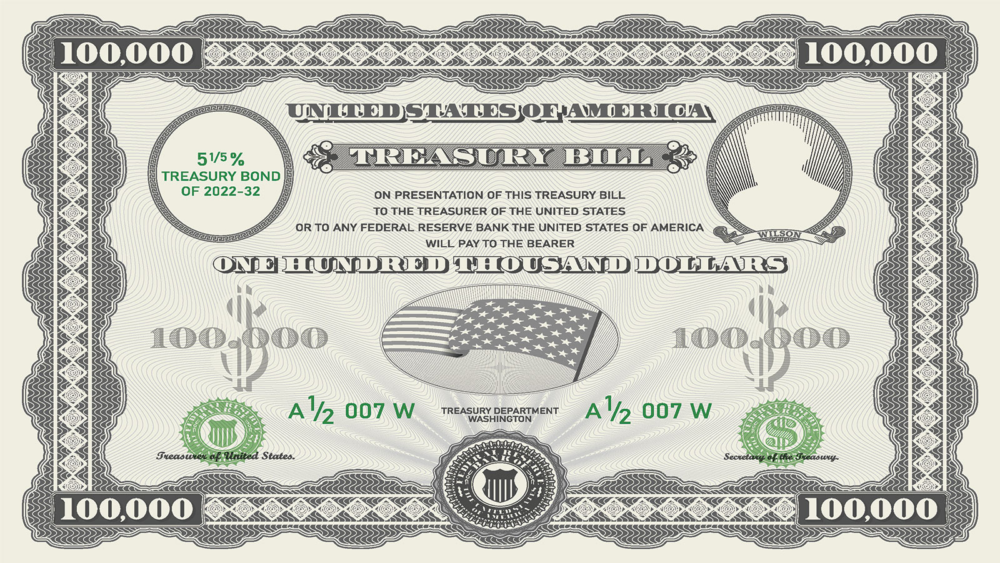

Here are all the links to sources of Data for the project-:

[CBO (Congressional Budget Office) budget projections and long term GDP estimates](https://www.cbo.gov/publication/58848)- Here click Data underlying figures, 10 year budget projections, and 10 year economic projections for the Data.

[2022 CBO Data for discretionary Spending](https://www.cbo.gov/publication/58890)

[2019 CBO Data for discretionary spending](https://www.cbo.gov/publication/56326)

[Nutrition Assistance Fiscal Multiplier](https://www.ers.usda.gov/webdocs/publications/93529/err265_summary.pdf)- The Supplemental Nutrition Assistance Program and Child Nutrition spending have been clubbed together into the Category of Nutrition Assistance.

[Fiscal Multipliers for Income security, Defense, Tax Credits](https://www.moodysanalytics.com/-/media/article/2021/economic-assessment-of-bIden-fiscal-rescue-package.pdf?ftag=MSF0951a18) Supplemental Income Security, Unemployment Compensation, and Income Security(Discretionary Spending) have been clubbed together as income security. All Tax credits mentioned in the CBO report have been merged together into the Tax credits category.

[Social Security Expenditure Multiplier](https://www.sciencedirect.com/science/article/abs/pii/S0304393220300416)

[Fiscal Multipliers for Education Expenditures](https://www.federalreserve.gov/econres/feds/files/2020058pap.pdf)- Federal Higher Education Expenditures, The Education Stablization Fund and Education, Employment, Training and Social Services (Discretionary) have been grouped together into Education Expenditures.

[Multipliers for Infrastructure Expenditure](https://www.epi.org/publication/the-potential-macroeconomic-benefits-from-increasing-infrastructure-investment/)- Expenses on Infrastructure, Investment and Jobs Act (IIJA)(Discretionary)

[Individual, Payroll and Corporate Tax Multipliers](https://www.imf.org/external/pubs/ft/tnm/2014/tnm1404.pdf)

[Federal Retirement and Veterans Expenditure Multiplier](https://www.nirsonline.org/2021/01/pension-spending-supports-1-3-trillion-in-output-6-9-million-jobs-192-billion-in-tax-revenue-across-u-s-economy/)- Federal Retirement Spending and Spending on Veterans has been clubbed together into Retirement Spending.

[Transportation Spending Multiplier](https://nap.nationalacademies.org/resource/18628/sr312LW.pdf)

[Environmental Spending Multiplier](https://www.elibrary.imf.org/view/journals/001/2021/087/article-A001-en.xml)

[Public Health Insurance Fiscal Multiplier](https://www.dallasfed.org/research/papers/2021/wp2112)- Medicare, Medicaid, Children's Health Insurance, MEHRCF have been grouped together into Public Health insurance.

[Health Expenditure Fiscal Multiplier Figure 2b](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3849102/)

I could not find multiplier estimates for the other categories so we make assumptions based on the nature of the expenditure and the available multipliers. Science expenditure, Family Support, and Community and regional development are categories of high importance so they are assumed to have a multiplier of 1.5. All others have a multiplier of 1.

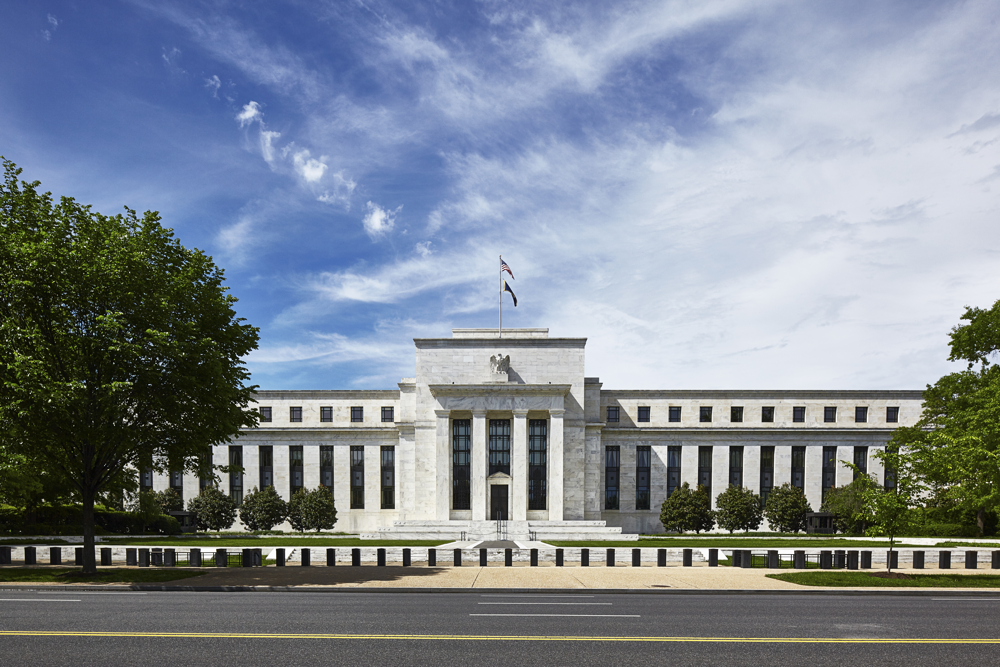

## 2. Mathematical model ##

#### We have 4 variables in the original Mathematical Model-:

1) Change in tax collection for each of the tax categories

2) Change in spending for each of the expenditure categories

3) Change in GDP as a result of change in Taxation for each tax category.

4) Change in GDP as a result of change in Spending for each spending category.

In the more advanced version of the model, we will add two more variables-:

5) Further Change in Total Tax collection as a result of Multiplier effect of all the initial spending changes on economic output from which tax is collected.(called reciprocal taxes from expenditure)

6) Further change in total tax collection as a result of Multiplier effect of all initial tax increases on economic output from which tax is collected.(called reciprocal taxes from taxation)

#### We have the following constraints-:

1) Since we have to reduce the deficit, it makes sense that no taxes are reduced. Hence, all tax change variables are going to be greater than or equal to zero.

2) As for the spending Change categories, most of them need to be greater than or equal to zero. Some examples are social security spending and public health insurance. These are areas of spending where a reduction would be deeply unpopular among the general public, and many people will be harmfully impacted.


 3) The only categories where reduction in expenses is allowed are Defense, Tax Credits, and Others. Defense spending originally is 800 Billion Dollars, and given the current state of the world a reduction of more than 100 Billion dollars is not a good idea. On the other side, excessive increases in defense expenditure are unpopular among the general public, hence we allow defense expenditures to increase by no more than 100 Billion dollars. Tax credits include some important transfers like child tax credits credits which should not be reduced considering their beneficial Impacts, but reductions can be made on other tax credit categories clumped into this one variable. The original spending on Tax credits is a 188 Billion dollars, we allow a reduction of no more than 20 Billion. The Others category includes several covid related expenditures which can all be fully reduced as the Pandemic is basically over. Hence here we allow a reduction of upto 25 billion dollars. But all other expenditures in this category are most obligations for the government in figures which cannot be changed like interest payments, hence beyond reductions on covid related expenditures, this category doesn't change.
 
 
 4) Taxes are not allowed to increase by more than 40% of the original amount. This is done to ensure the solvability of the model with a practical solution.
 
 5) Similarly, expenditures are allowed to increase by no more than 25% of the original amount for the same aforementioned reason.
 
 6) The increase in Tax collection from medicare premiums and payroll taxes combined which are earmarked for social security and public health insurance expenditures should be greater than or equal to increase in spending in the categories, so that the solvency of the Social Security system and public health insurance doesn't deteriorate.
 
 7) The Change in GDP as a result of change in (Taxation/Spending) is equal to the change multiplied by the multiplier for that (Tax/Expenditure) category.
 
 8) The GDP for 2023 must be at least the same as GDP of 2022. The GDP in 2022 was 25,016 billion dollars, and the originally forecasted GDP for 2023 before our budget optimization is 26,238 Billion dollars. Hence, The sum of GDP changes as a result of Change in expenditures minus the sum of GDP changes as a result of taxation (Net GDP reduction) should not go lower than 1,222 Billion dollars.
 
9) The minimum increases in Corporate, Individual, and "Others" Tax categories must be 164, 108 and 68 Billion Dollars respectively, for them to at least match the Tax increases listed under the [2024 Proposed Budget by the White House.](https://www.whitehouse.gov/wp-content/uploads/2023/03/ap_17_receipts_fy2024.pdf) Even though this budget is proposed for 2024, this does provide us a minimum target of tax collection increases in these categories that we should aim to reach.
 
 #### Our Objective function
 
 Our objective funtion is to minimize the budget deficit with a regularizer added that aims to minimize the net reduction in GDP.
 
 Minimize-: Budget_Deficit + (((net reduction in GDP)/lambda)^3)
 
 where net reduction in GDP is = GDP Change due to increase in taxes - GDP Change due to change in Expenditures.
 and budget deficit = (Total Expenditures - total revenues)
 
 In the more advanced version, budget deficit = (Total Expenditures + Change in Tax collection as a result of GDP changes from initial tax increases - total revenues - Change in tax collections as a result of GDP changes from initial spending changes.)
 
 The Change in Tax collection as a result of GDP changes from initial tax increases is always going to be negative as increases in taxes reduce the GDP, lowering the economic output to tax from, which you can kind of call an expenditure as it's money that the government is losing out on.
 
The Change in tax collections as a result of GDP changes from initial spending changes is usually going to be positive as most spending categories are not allowed to see a decrease, so it's just another form of tax collection. Even in the case this variable would somehow itself be negative (when even spending changes make the government lose out on tax revenues), the negative sign which is already attached to the variable in the objective function would turn the whole thing positive, just like expenditures, hence the model will also take care of counting it as an expenditure in that case.

#### The mathematical Model

$$
\begin{aligned}
\underset{\text{tax change, gdp change tax} \in \mathbb{R^5}\text{ exp change, gdp change exp} \in \mathbb{R^\text{18}}}{\text{minimize}}\qquad& \text{initial total expenditures + $\displaystyle \sum \text{exp change}$ - initial total taxes - $\displaystyle \sum \text{tax change}$ + (($\displaystyle \sum \text{gdp change tax}$ - $\displaystyle \sum \text{gdp_change_exp}$)/$\lambda$)$^3$} \\
\text{subject to:}\qquad& \text{initial tax collection from category i}\times0.4 \ge \text{tax change}(i) \ge 0 \\
& \text{tax change}(corporation) \ge 164 \\
& \text{tax change}(individual) \ge 108 \\
& \text{tax change}(others) \ge 68 \\
& \text{tax change}(payroll) + \text{tax_change}(\text{medicare premium}) \ge \text{exp change}(\text{social security}) + \text{exp change}(\text{public health insurance})\\
& 100 \ge \text{exp change}(defense) \ge -100 \\
& 50 \ge \text{exp change}(\text{tax credits}) \ge -20 \\
& 0 \ge \text{exp change}(\text{others}) \ge -25 \\
& \text{initial expenditure on category j}\times0.25 \ge \text{exp change}(j) \ge 0 \\
& \text{gdp change tax}(i) = \text{tax change}(i)\times\text{Fiscal Multiplier for the tax category i} \\
& \text{gdp change exp}(k) = \text{exp change}(k)\times\text{Fiscal Multiplier for the expenditure category k} \\
& \text{$\displaystyle \sum \text{gdp change exp}$ - $\displaystyle \sum \text{gdp change tax}$} \ge -1222 \\
& \textit{for i $\in$ \{individual, payroll, corporate, medicare premium, others\}}\\
& \textit{for k in all expenditure categories} \\
& \textit{for j in (all individual categories except defense, tax credits and others)} \\
& \textit{All variables in Billions of dollars} \\
& \textit{$\lambda$ in [1, $\infty$)}
\end{aligned}
$$

All expenditure categories-:
{social security, public health insurance, nutrition assistance, tax credits, income security, family support,
    federal retirement, defense, health, transportation, international affairs, justice, community and regional development, environment, others, infrastructure, ETES, science}
    
ETES is an acronym for education, training employment and social services.

We only have the grand total of spending on discretionary non defense expenditures by the government for 2023 of 886 Billion dollars, but no breakdowns into categories in this optimization problem except for infrastructure spending. Categories fully part of this set are Health, Transportation, Justice, International Affairs, Community and regional development, enviroment and science. These discretionary expenditures also partly contribute alongside mandatory expenditures (which we have data for) in categories ETES, Federal retirement, income security and others. I've had to make estimates for these expenditure amounts based on discretionary expenditure data for 2019 and 2022 which we have the full breakdown for.

I looked at health expenditures for both 2019 and 2022, and in 2022 health expenditure was highly elevated due to the pandemic. I arrived at the figure of 86 Billion dollars for 2023 by taking the 66 billion dollar figure for 2019 and adjusting it for inflation and GDP growth over time. We are still left with 886-86 = 800 Billion dollars of 2023 expenditures to estimate

For all the other remaining categories, I looked at the 2022 breakdown of discretionary non defense spending, totalling 910 Billion dollars. After removing the 141 Billion dollars for healthcare, we are left with 769 Billion dollars. For all the other expenditures, I multiplied the 2022 figure by (800/769) to estimate the 2023 expenditure.

The links to data from the [Congressional Budget Office(CBO)](https://en.wikipedia.org/wiki/Congressional_Budget_Office) used for these estimations are listed above in the introduction section.

#### Mathematical Model for the advanced version

$$
\begin{aligned}
\underset{\text{tax change, gdp change tax} \in \mathbb{R^5}\text{ exp change, gdp change exp} \in \mathbb{R^\text{18}} \text{reciprocal taxes tax, reciprocal taxes exp} \in \mathbb{R^1}}{\text{minimize}}\qquad& \text{initial total expenditures + $\displaystyle \sum \text{exp change}$ + reciprocal taxes tax - initial total taxes - $\displaystyle \sum \text{tax change}$ - reciprocal taxes exp+ (($\displaystyle \sum \text{gdp change tax}$ - $\displaystyle \sum \text{gdp_change_exp}$)/$\lambda$)$^3$} \\
\text{subject to:}\qquad& \text{initial tax collection from category i}\times0.4 \ge \text{tax change}(i) \ge 0 \\
& \text{reciprocal taxes tax = $\frac{\text{initial total taxes} + \displaystyle \sum \text{tax change}}{\text{initial GDP} +\displaystyle \sum \text{gdp_change_exp}-\displaystyle \sum \text{gdp change tax}}$}\times\displaystyle \sum \text{gdp change tax} \\
& \text{reciprocal taxes exp = $\frac{\text{initial total taxes} + \displaystyle \sum \text{tax change}}{\text{initial GDP} +\displaystyle \sum \text{gdp_change_exp}-\displaystyle \sum \text{gdp change tax}}$}\times\displaystyle \sum \text{gdp change exp} \\
& \text{tax change}(corporation) \ge 164 \\
& \text{tax change}(individual) \ge 108 \\
& \text{tax change}(others) \ge 68 \\
& \text{tax change}(payroll) + \text{tax_change}(\text{medicare premium}) \ge \text{exp change}(\text{social security}) + \text{exp change}(\text{public health insurance})\\
& 100 \ge \text{exp change}(defense) \ge -100 \\
& 50 \ge \text{exp change}(\text{tax credits}) \ge -20 \\
& 0 \ge \text{exp change}(\text{others}) \ge -25 \\
& \text{initial expenditure on category j}\times0.25 \ge \text{exp change}(j) \ge 0 \\
& \text{gdp change tax}(i) = \text{tax change}(i)\times\text{Fiscal Multiplier for the tax category i} \\
& \text{gdp change exp}(k) = \text{exp change}(k)\times\text{Fiscal Multiplier for the expenditure category k} \\
& \text{$\displaystyle \sum \text{gdp change exp}$ - $\displaystyle \sum \text{gdp change tax}$} \ge -1222 \\
& \textit{for i $\in$ \{individual, payroll, corporate, medicare premium, others\}}\\
& \textit{for k in all expenditure categories} \\
& \textit{for j in (all individual categories except defense, tax credits and others)} \\
& \textit{All variables in Billions of dollars} \\
& \textit{$\lambda$ in [1, $\infty$)}
\end{aligned}
$$

Explanation of the reciprocal taxes variables-: As stated earlier, these 2 variables capture the effect of change in GDP as a result of initial tax increases and spending increases on total tax collection, as the government collects tax from Economic Activity. Think of it as budget changes impacted gdp which then comes back by impacting tax revenues.

We take the new tax to GDP ratio that would come about as a result of intial govt. budget changes and it's impacts on the economy. We then multiply that by the total change in GDP as a result of initial taxation changes and spending, and we can then figure out the impact of the GDP change on tax revenues.

The objective function is a Non Linear function in both the models. In the original model, all constraints are linear. In the advanced model, the reciprocal_taxes_tax and reciprocal_taxes_exp constraints are non-linear.

Hence both the versions of the Optimization problem are NLP.

## 3. Solution ##

#### Clarifying confusing spending category names-: com_reg is community and regional development, env is environment, and ETES is education, training, employment and social services.

In [1]:
using JuMP, Ipopt
taxes = [:individual, :payroll, :corporation, :medicare_premium, :others]
expenditures = [:social_security, :public_health_insurance, :nutrition_assistance, :tax_credits, :income_security, :family_support,
    :fed_retirement, :defense, :health, :transportation, :international_affairs, :justice, :com_reg, :env, :others_exogenous, :infrastructure, :ETES, :science]
tax_mult = [1.4, 1.4, 0.4, 1, 1]
exp_mult = [1.1, 1.5, 1.5, 1.27, 1.49, 1.5, 2.19, 1.24, 1.92, 1.47, 1, 1, 1.5, 1.3, 1, 1.7, 2.27, 1.5]
tax_mult_dict = Dict(zip(taxes, tax_mult))
exp_mult_dict = Dict(zip(expenditures, exp_mult))
initial_tax = [2523, 1562, 475, 178, 428]
initial_exp = [1336, 1617, 161, 188, 194, 48, 487, 800, 86, 117, 74, 71, 48, 46, 1056, 21, 175, 38]
initial_tax_dict = Dict(zip(taxes, initial_tax))
initial_exp_dict = Dict(zip(expenditures, initial_exp))
initial_gdp = 26238
initial_taxes_total = sum(initial_tax)
initial_exp_total = sum(initial_exp)
max_allowed_decrease = -1222
#The following list includes all the expenditures which are not allowed to decrease
exp_no_dec = [:com_reg, :env, :public_health_insurance, :fed_retirement, :income_security, :social_security, :family_support, :infrastructure,
    :international_affairs, :ETES, :nutrition_assistance, :science, :justice, :transportation, :health]

15-element Vector{Symbol}:
 :com_reg
 :env
 :public_health_insurance
 :fed_retirement
 :income_security
 :social_security
 :family_support
 :infrastructure
 :international_affairs
 :ETES
 :nutrition_assistance
 :science
 :justice
 :transportation
 :health

#### Now we will run the first version of the model with values of 𝜆 = 1, 10, 25, 50, 90, 120, 150, 175, 190, 200. We will see that increasing 𝜆 beyond a specific value doesn't have any impact on the solution as GDP hits the lower bound. This will be further analysed in the discussion section. We will be initializing zero vectors in the cell below and updating their values with each iteration of both models with different values of 𝜆.

In [2]:
Npts = 10
GDPm1 = zeros(Npts)
Deficitm1 = zeros(Npts)
GDPm2 = zeros(Npts)
Deficitm2 = zeros(Npts)

10-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0

In [3]:
using JuMP, Ipopt, NamedArrays
𝜆 = 1
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[1] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[1] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total
Taxm1_1 = NamedArray([value(tax_change[i]) for i in taxes], (taxes), ("Taxes") )
Expm1_1 = NamedArray([value(exp_change[i]) for i in expenditures], (expenditures), ("Expenditures") )


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality co

18-element Named Vector{Float64}
Expenditures             │ 
─────────────────────────┼────────────
:social_security         │   1.6949e-9
:public_health_insurance │      404.25
:nutrition_assistance    │       40.25
:tax_credits             │       -20.0
:income_security         │        48.5
:family_support          │        12.0
:fed_retirement          │      121.75
:defense                 │      -100.0
:health                  │        21.5
:transportation          │       29.25
:international_affairs   │ -1.22775e-9
:justice                 │ -1.22765e-9
:com_reg                 │        12.0
:env                     │  2.51266e-8
:others_exogenous        │       -25.0
:infrastructure          │        5.25
:ETES                    │       43.75
:science                 │         9.5

In [4]:
using JuMP, Ipopt
𝜆 = 10
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[2] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[2] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

1016.8551142124406

In [5]:
using JuMP, Ipopt
𝜆 = 25
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[3] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[3] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

984.3098145240037

In [6]:
using JuMP, Ipopt
𝜆 = 50
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[4] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[4] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

904.6507893261278

In [7]:
using JuMP, Ipopt
𝜆 = 90
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[5] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[5] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

730.2917499963132

In [8]:
using JuMP, Ipopt
𝜆 = 120
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[6] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[6] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total
Taxm1_120 = NamedArray([value(tax_change[i]) for i in taxes], (taxes), ("Taxes") )
Expm1_120 = NamedArray([value(exp_change[i]) for i in expenditures], (expenditures), ("Expenditures") )

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

18-element Named Vector{Float64}
Expenditures             │ 
─────────────────────────┼────────────
:social_security         │  1.69484e-9
:public_health_insurance │      404.25
:nutrition_assistance    │       40.25
:tax_credits             │       -20.0
:income_security         │        48.5
:family_support          │        12.0
:fed_retirement          │      121.75
:defense                 │      -100.0
:health                  │        21.5
:transportation          │       29.25
:international_affairs   │ -1.22715e-9
:justice                 │ -1.22706e-9
:com_reg                 │        12.0
:env                     │  2.51388e-8
:others_exogenous        │       -25.0
:infrastructure          │        5.25
:ETES                    │       43.75
:science                 │         9.5

In [9]:
using JuMP, Ipopt
𝜆 = 150
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[7] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[7] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

387.5757413556221

In [10]:
using JuMP, Ipopt
𝜆 = 175
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[8] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[8] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

221.00525162534905

In [11]:
using JuMP, Ipopt
𝜆 = 190
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[9] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[9] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

155.01963051069924

In [12]:
using JuMP, Ipopt
𝜆 = 200
m1 = Model(Ipopt.Optimizer)

@variable(m1, tax_change[taxes] >= 0)
@variable(m1, exp_change[expenditures])
@variable(m1, gdp_change_tax[taxes])
@variable(m1, gdp_change_exp[expenditures])

@constraint(m1, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m1, tax_change[:corporation] >= 164)
@constraint(m1, tax_change[:individual] >= 108)
@constraint(m1, tax_change[:others] >= 68)
@constraint(m1, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m1, 100 >= exp_change[:defense] >= -100)
@constraint(m1, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m1, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m1, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m1, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m1, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m1, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m1, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) - sum(tax_change[i] for i in taxes) - initial_taxes_total) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m1)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit is ", (initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total), " billion dollars")
GDPm1[10] = initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm1[10] = initial_exp_total+sum(value.(exp_change)) - sum(value.(tax_change)) - initial_taxes_total
Taxm1_200 = NamedArray([value(tax_change[i]) for i in taxes], (taxes), ("Taxes") )
Expm1_200 = NamedArray([value(exp_change[i]) for i in expenditures], (expenditures), ("Expenditures") )

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:       46
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:      276

Total number of variables............................:       46
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       23
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.22e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

18-element Named Vector{Float64}
Expenditures             │ 
─────────────────────────┼────────────
:social_security         │  1.69509e-9
:public_health_insurance │      404.25
:nutrition_assistance    │       40.25
:tax_credits             │       -20.0
:income_security         │        48.5
:family_support          │        12.0
:fed_retirement          │      121.75
:defense                 │      -100.0
:health                  │        21.5
:transportation          │       29.25
:international_affairs   │ -1.22694e-9
:justice                 │ -1.22685e-9
:com_reg                 │        12.0
:env                     │  2.51437e-8
:others_exogenous        │       -25.0
:infrastructure          │        5.25
:ETES                    │       43.75
:science                 │         9.5

### Implementation of the advanced model

The vector below will store the net reciprocal tax changes for selected values of lambda for later analysis.

In [13]:
net_reciprocal_tax_changes = zeros(3)

3-element Vector{Float64}:
 0.0
 0.0
 0.0

In [14]:
using JuMP, Ipopt
𝜆 = 1
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[1]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[1]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)
Taxm2_1 = NamedArray([value(tax_change[i]) for i in taxes], (taxes), ("Taxes") )
Expm2_1 = NamedArray([value(exp_change[i]) for i in expenditures], (expenditures), ("Expenditures") )
net_reciprocal_tax_changes[1] = value(reciprocal_taxes_exp) - value(reciprocal_taxes_tax)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

-0.09361272396617437

In [15]:
using JuMP, Ipopt
𝜆 = 10
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[2]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[2]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

1021.810218424168

In [16]:
using JuMP, Ipopt
𝜆 = 25
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[3]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[3]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

1004.0312697047323

In [17]:
using JuMP, Ipopt
𝜆 = 50
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[4]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[4]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

961.3582004985858

In [18]:
using JuMP, Ipopt
𝜆 = 80
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[5]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[5]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

896.1886213761136

In [19]:
using JuMP, Ipopt
𝜆 = 120
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[6]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[6]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)
Taxm2_120 = NamedArray([value(tax_change[i]) for i in taxes], (taxes), ("Taxes") )
Expm2_120 = NamedArray([value(exp_change[i]) for i in expenditures], (expenditures), ("Expenditures") )
net_reciprocal_tax_changes[2] = value(reciprocal_taxes_exp) - value(reciprocal_taxes_tax)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

-127.53882953399238

In [20]:
using JuMP, Ipopt
𝜆 = 150
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[7]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[7]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

712.3958300918266

In [21]:
using JuMP, Ipopt
𝜆 = 175
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[8]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[8]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

642.0215953978652

In [22]:
using JuMP, Ipopt
𝜆 = 190
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[9]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[9]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

599.6120340638272

In [23]:
using JuMP, Ipopt
𝜆 = 200
m2 = Model(Ipopt.Optimizer)

@variable(m2, tax_change[taxes] >= 0)
@variable(m2, exp_change[expenditures])
@variable(m2, gdp_change_tax[taxes])
@variable(m2, gdp_change_exp[expenditures])
@variable(m2, reciprocal_taxes_tax)
@variable(m2, reciprocal_taxes_exp)

@NLconstraint(m2, reciprocal_taxes_tax == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_tax[i] for i in taxes))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@NLconstraint(m2, reciprocal_taxes_exp == ((initial_taxes_total + sum(tax_change[i] for i in taxes))*sum(gdp_change_exp[i] for i in expenditures))/(initial_gdp+sum(gdp_change_exp[i] for i in expenditures)-sum(gdp_change_tax[i] for i in taxes)))
@constraint(m2, const4[i in taxes], tax_change[i] <= 0.4*initial_tax_dict[i])
@constraint(m2, tax_change[:corporation] >= 164)
@constraint(m2, tax_change[:individual] >= 108)
@constraint(m2, tax_change[:others] >= 68)
@constraint(m2, tax_change[:payroll] + tax_change[:medicare_premium] >= exp_change[:social_security]+exp_change[:public_health_insurance])
@constraint(m2, 100 >= exp_change[:defense] >= -100)
@constraint(m2, 50 >= exp_change[:tax_credits] >= -20)
@constraint(m2, 0 >= exp_change[:others_exogenous] >= -25)
@constraint(m2, const3[i in exp_no_dec], 0 <= exp_change[i] <= 0.25 * initial_exp_dict[i])
@NLconstraint(m2, const1[i in taxes], gdp_change_tax[i] == tax_change[i]*tax_mult_dict[i])
@NLconstraint(m2, const2[i in expenditures], gdp_change_exp[i] == exp_change[i]*exp_mult_dict[i])
@constraint(m2, sum(gdp_change_exp[i] for i in expenditures) - sum(gdp_change_tax[i] for i in taxes) >= max_allowed_decrease)

@NLobjective(m2, Min, (initial_exp_total+sum(exp_change[i] for i in expenditures) + reciprocal_taxes_tax - sum(tax_change[i] for i in taxes) - initial_taxes_total-reciprocal_taxes_exp) + ((sum(gdp_change_tax[i] for i in taxes)- sum(gdp_change_exp[i] for i in expenditures))/𝜆)^3)
optimize!(m2)

for i in taxes
    println("Original collection from ", i, " was ", initial_tax_dict[i], ", billion dollars, and new intended collection is ", initial_tax_dict[i] + value(tax_change[i]), " billion dollars")
end
println("==========================================================================================")
for i in expenditures
    println("Original spending on ", i, " was ", initial_exp_dict[i], ", and new spending is ", initial_exp_dict[i] + value(exp_change[i]))
end

println("==========================================================================================")
println("Old GDP was ", initial_gdp, " billion dollars and New GDP is ", initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax)), " billion dollars")
println("Original deficit was ", initial_exp_total - initial_taxes_total, " billion dollars and New Deficit taking into account the reciprocal effect is ", (initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)), " billion dollars")
GDPm2[10]=initial_gdp+sum(value.(gdp_change_exp))-sum(value.(gdp_change_tax))
Deficitm2[10]=initial_exp_total+sum(value.(exp_change)) + value(reciprocal_taxes_tax) - sum(value.(tax_change)) - initial_taxes_total - value(reciprocal_taxes_exp)
Taxm2_200 = NamedArray([value(tax_change[i]) for i in taxes], (taxes), ("Taxes") )
Expm2_200 = NamedArray([value(exp_change[i]) for i in expenditures], (expenditures), ("Expenditures") )
net_reciprocal_tax_changes[3] = value(reciprocal_taxes_exp) - value(reciprocal_taxes_tax)

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.5.1.

Number of nonzeros in equality constraint Jacobian...:      104
Number of nonzeros in inequality constraint Jacobian.:       71
Number of nonzeros in Lagrangian Hessian.............:     1088

Total number of variables............................:       48
                     variables with only lower bounds:        5
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       25
Total number of inequality constraints...............:       46
        inequality constraints with only lower bounds:       23
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       23

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.3969500e+03 1.64e+02 5.11e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

-282.12301405978405

## 4. Results and discussion ##

### 4.A. Comparison of both models

First, we are going to plot curves that show the relationship between lambda and GDP and deficit for both the models and also compare these models.

In [24]:
lambdas = [1, 10, 25, 50, 80, 120, 150, 175, 190, 200]

10-element Vector{Int64}:
   1
  10
  25
  50
  80
 120
 150
 175
 190
 200

In [25]:
initial_deficit = initial_exp_total - initial_taxes_total
initial_deficit_vector = [initial_deficit, initial_deficit, initial_deficit, initial_deficit, initial_deficit, initial_deficit, initial_deficit, initial_deficit, initial_deficit, initial_deficit]
no_deficit_vector = zeros(10)

10-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0

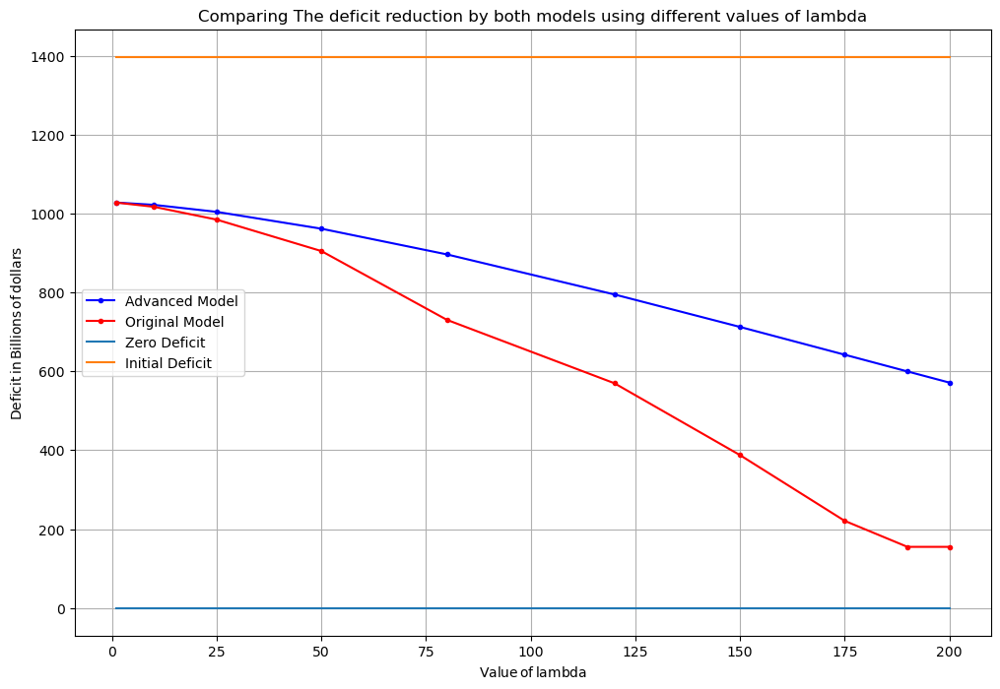

In [26]:
using PyPlot
figure(figsize=(12,8))
plot( lambdas, Deficitm2, "b.-", label = "Advanced Model")
plot( lambdas, Deficitm1, "r.-", label = "Original Model")
plot( lambdas, no_deficit_vector, label ="Zero Deficit")
plot( lambdas, initial_deficit_vector, label = "Initial Deficit")
legend(["Advanced Model", "Original Model", "Zero Deficit", "Initial Deficit"])
xlabel(L"\sf Value\, of\, lambda")
ylabel(L"\sf Deficit\, in\, Billions\, of\, dollars");
title("Comparing The deficit reduction by both models using different values of lambda")
grid()

In [27]:
initial_gdp_vector = [initial_gdp, initial_gdp, initial_gdp, initial_gdp, initial_gdp, initial_gdp, initial_gdp, initial_gdp, initial_gdp, initial_gdp]
lower_bound_gdp_vector = [25016, 25016, 25016, 25016, 25016, 25016, 25016, 25016, 25016, 25016] # As stated in the Introduction, the GDP for previous year that is 25,016 billion dollars is the lower bound for GDP

10-element Vector{Int64}:
 25016
 25016
 25016
 25016
 25016
 25016
 25016
 25016
 25016
 25016

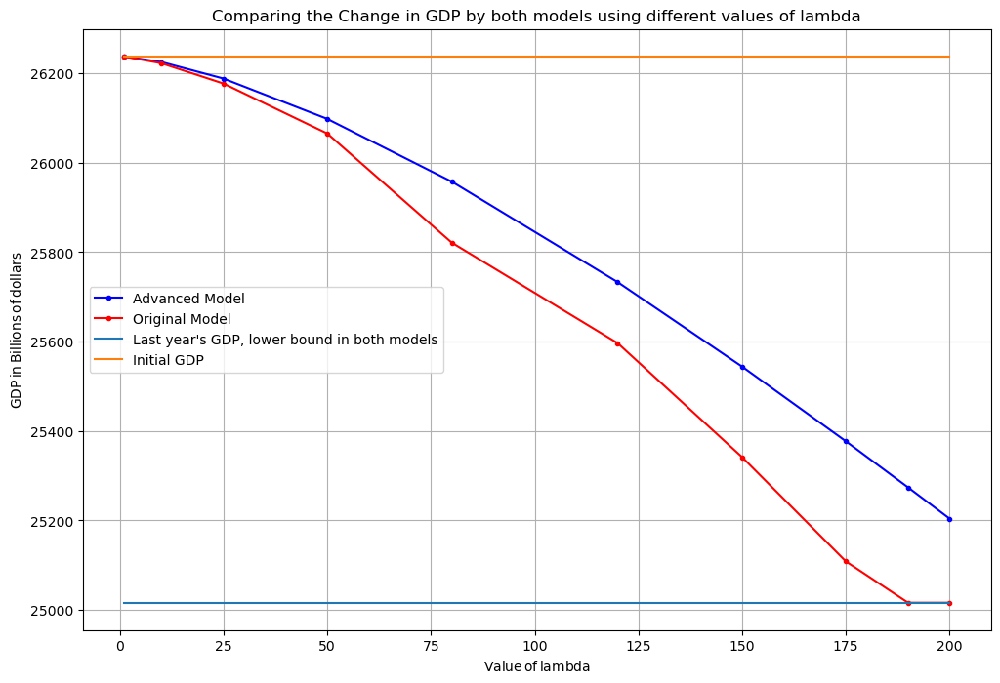

In [28]:
using PyPlot
figure(figsize=(12,8))
plot( lambdas, GDPm2, "b.-", label = "Advanced Model")
plot( lambdas, GDPm1, "r.-", label = "Original Model")
plot( lambdas, lower_bound_gdp_vector, label ="Last year's GDP, lower bound in both models")
plot( lambdas, initial_gdp_vector, label = "Initial GDP")
legend(["Advanced Model", "Original Model", "Last year's GDP, lower bound in both models", "Initial GDP"])
xlabel(L"\sf Value\, of\, lambda")
ylabel(L"\sf GDP\, in\, Billions\, of\, dollars");
title("Comparing the Change in GDP by both models using different values of lambda")
grid()

From the plots, we can see that the advanced model is much less successful when it comes to reduction in deficit, but with an increasing value of lambda, it does a better job of preventing loss in economic output compared to the original model.

### 4.B. Taxation and Expenditure Change analysis

Here we will look at the changes in taxation and federal spending from both models from hand picked values of lambda. Using all lambda values is tedious, so we will choose only 3. The two extremities of 1 and 200. For the middle, we can choose between 80 and 120. I picked 120, because the change in GDP and taxation across both models is closest to the average of extreme outcomes for both models if lambda is 120. You can look at the graphs above to confirm this

#### Analysis of Expenditure Changes

Here we will use Graphs to compare the changes in expenditures across both models and all 3 chosen lambdas.

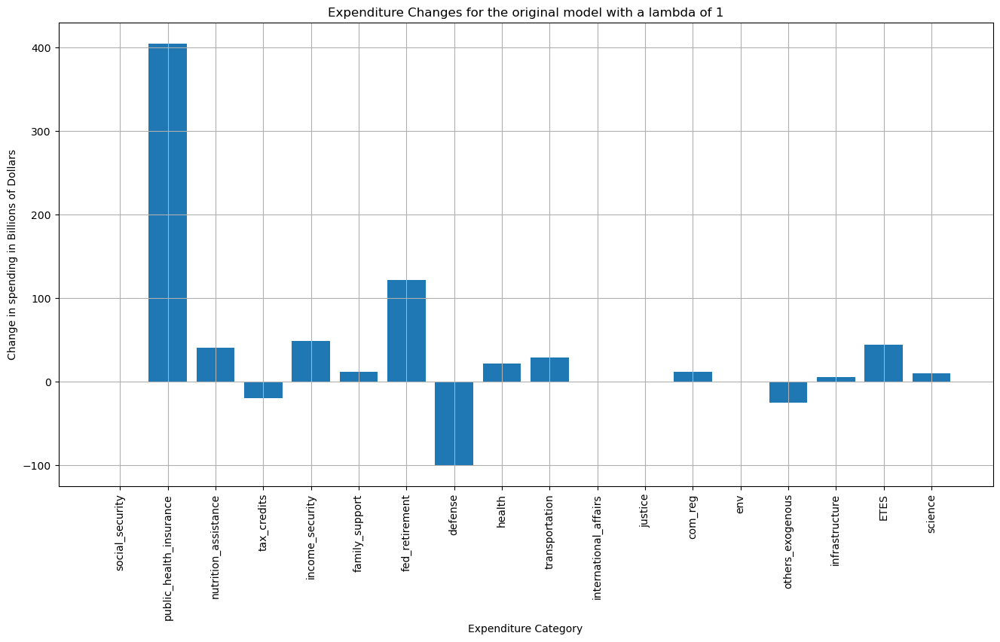

PyObject Text(0.5, 1.0, 'Expenditure Changes for the original model with a lambda of 1')

In [29]:
using PyPlot
figure(figsize=(16,8))
bar( expenditures, Expm1_1);
xticks(rotation=90)
xlabel("Expenditure Category"); ylabel("Change in spending in Billions of Dollars"); grid()
title("Expenditure Changes for the original model with a lambda of 1")

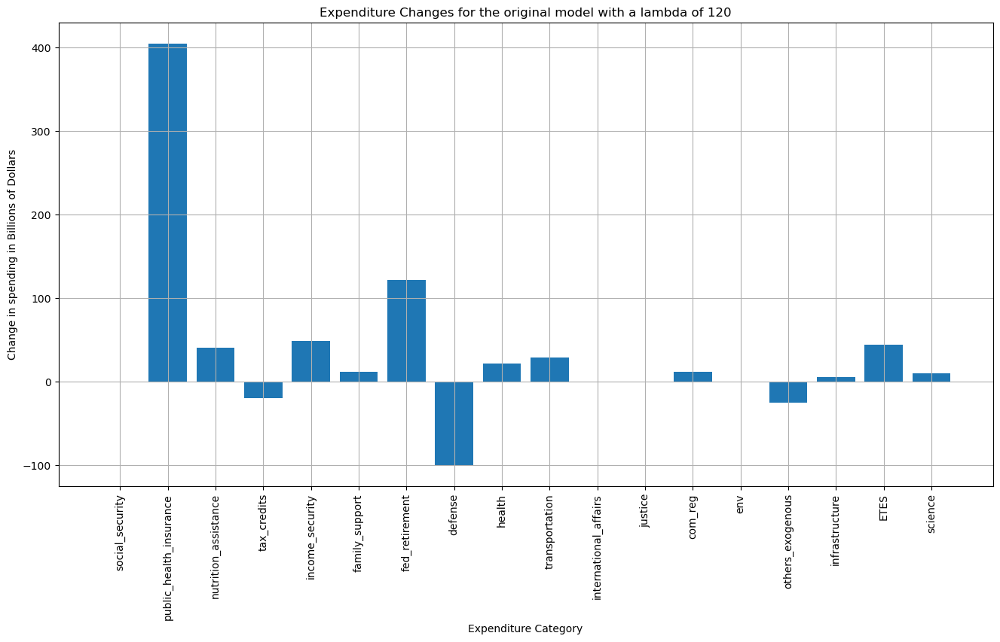

PyObject Text(0.5, 1.0, 'Expenditure Changes for the original model with a lambda of 120')

In [30]:
using PyPlot
figure(figsize=(16,8))
bar( expenditures, Expm1_120);
xticks(rotation=90)
xlabel("Expenditure Category"); ylabel("Change in spending in Billions of Dollars"); grid()
title("Expenditure Changes for the original model with a lambda of 120")

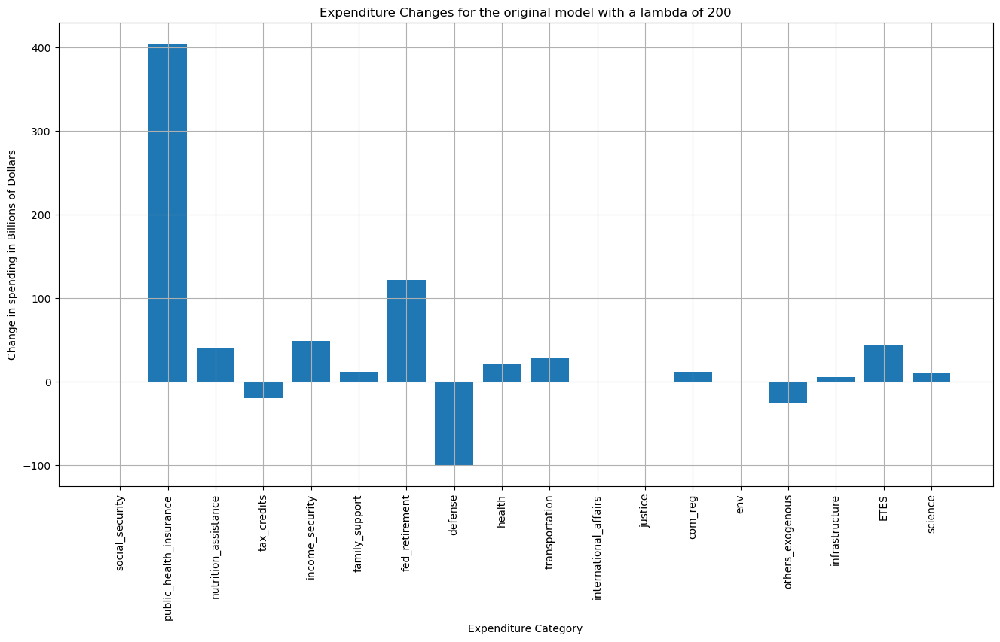

PyObject Text(0.5, 1.0, 'Expenditure Changes for the original model with a lambda of 200')

In [31]:
using PyPlot
figure(figsize=(16,8))
bar( expenditures, Expm1_200);
xticks(rotation=90)
xlabel("Expenditure Category"); ylabel("Change in spending in Billions of Dollars"); grid()
title("Expenditure Changes for the original model with a lambda of 200")

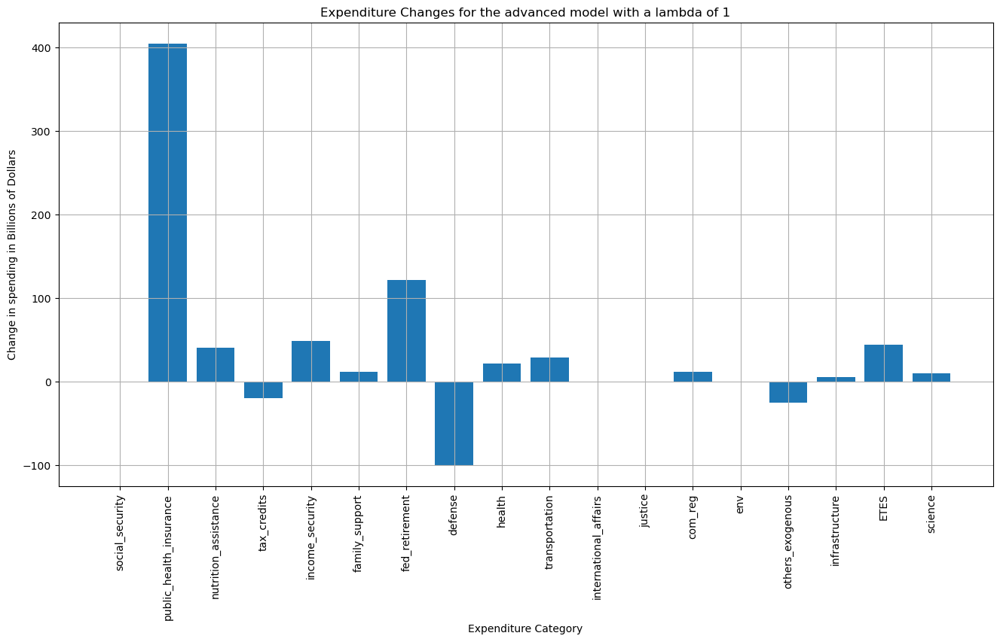

PyObject Text(0.5, 1.0, 'Expenditure Changes for the advanced model with a lambda of 1')

In [32]:
using PyPlot
figure(figsize=(16,8))
bar( expenditures, Expm2_1);
xticks(rotation=90)
xlabel("Expenditure Category"); ylabel("Change in spending in Billions of Dollars"); grid()
title("Expenditure Changes for the advanced model with a lambda of 1")

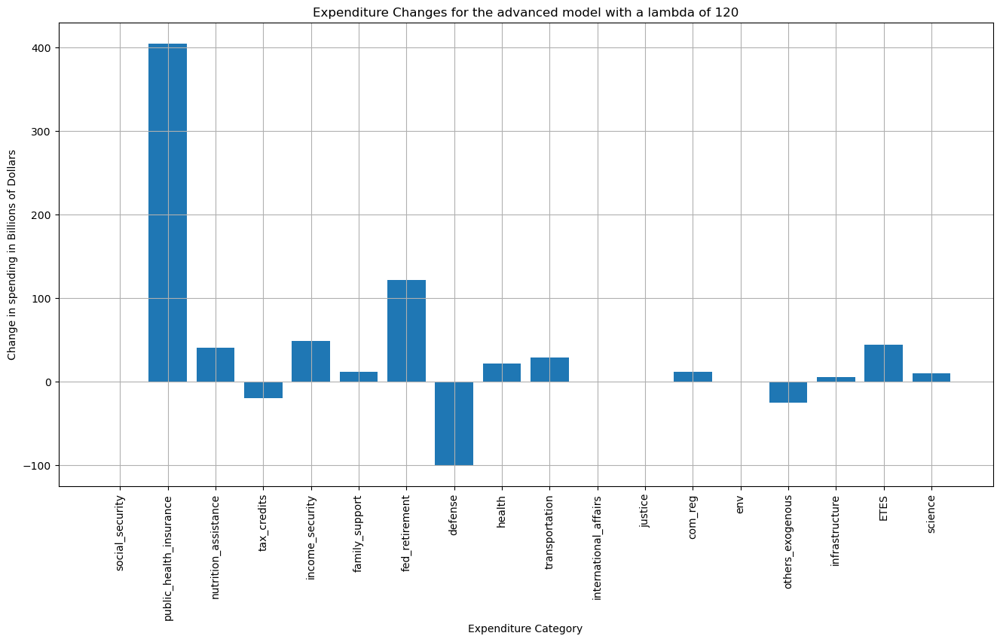

PyObject Text(0.5, 1.0, 'Expenditure Changes for the advanced model with a lambda of 120')

In [33]:
using PyPlot
figure(figsize=(16,8))
bar( expenditures, Expm2_120);
xticks(rotation=90)
xlabel("Expenditure Category"); ylabel("Change in spending in Billions of Dollars"); grid()
title("Expenditure Changes for the advanced model with a lambda of 120")

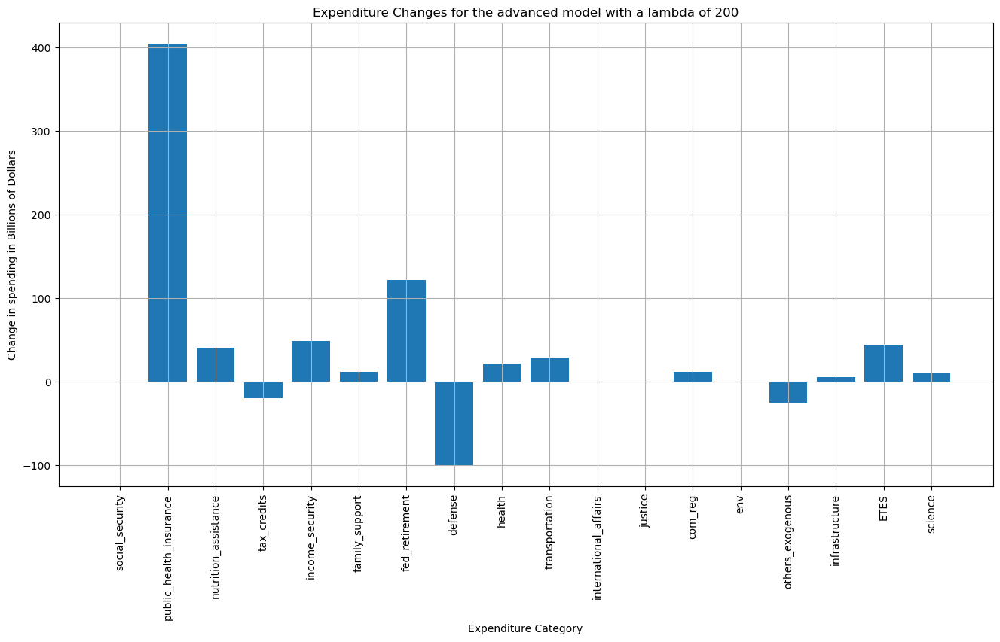

PyObject Text(0.5, 1.0, 'Expenditure Changes for the advanced model with a lambda of 200')

In [34]:
using PyPlot
figure(figsize=(16,8))
bar( expenditures, Expm2_200);
xticks(rotation=90)
xlabel("Expenditure Category"); ylabel("Change in spending in Billions of Dollars"); grid()
title("Expenditure Changes for the advanced model with a lambda of 200")

Shockingly, the changes in spending stay the same for all the models and lambdas. Spending on Public health insurance sees a significant jump, even though it's multiplier is lower than some other categories. This could probably be due to the 25% spending increase limit. Social security has a higher total expenditure, but because of the lower multiplier, the model chose to leave it unchanged.

Health insurance and retirement see the most significant jumps, and defense sees the most significant decline. Seems like our optimization problem somehow emphasized human welfare and quality of life while still reducing the deficit.

#### Analysis of Taxation Changes using tables

##### Original Model

In [35]:
Taxm1_1

5-element Named Vector{Float64}
Taxes             │ 
──────────────────┼────────
:individual       │ 172.214
:payroll          │ 367.858
:corporation      │   190.0
:medicare_premium │    71.2
:others           │   171.2

In [36]:
Taxm1_120

5-element Named Vector{Float64}
Taxes             │ 
──────────────────┼────────
:individual       │ 574.261
:payroll          │ 423.625
:corporation      │   190.0
:medicare_premium │    71.2
:others           │   171.2

In [37]:
Taxm1_200

5-element Named Vector{Float64}
Taxes             │ 
──────────────────┼────────
:individual       │ 873.874
:payroll          │ 538.707
:corporation      │   190.0
:medicare_premium │    71.2
:others           │   171.2

##### Advanced Model

In [38]:
Taxm2_1

5-element Named Vector{Float64}
Taxes             │ 
──────────────────┼────────
:individual       │ 170.965
:payroll          │ 369.044
:corporation      │   190.0
:medicare_premium │    71.2
:others           │   171.2

In [39]:
Taxm2_120

5-element Named Vector{Float64}
Taxes             │ 
──────────────────┼────────
:individual       │ 469.047
:payroll          │ 431.395
:corporation      │   190.0
:medicare_premium │    71.2
:others           │   171.2

In [40]:
Taxm2_200

5-element Named Vector{Float64}
Taxes             │ 
──────────────────┼────────
:individual       │ 783.954
:payroll          │ 494.352
:corporation      │   190.0
:medicare_premium │    71.2
:others           │   171.2

The following named array will give the net reciprocal tax changed in the advanced model for each of the 3 lambdas used for analysis.

In [41]:
using NamedArrays

reciprocal_tax_changes_named = NamedArray([value(net_reciprocal_tax_changes[i]) for i in 1:3], ([1, 120, 200]), ("Lambda") )

3-element Named Vector{Float64}
Lambda  │ 
────────┼───────────
1       │ -0.0936127
120     │   -127.539
200     │   -282.123

The only 2 categories that are seeing movement in revenues with changes in lambda and the model are Individual Income Taxes and Payroll Taxes. As lambda increases, the collection from the sources increases. Overall the changes in tax revenue stay higher in the original model than the advanced model. Also keep in mind that the advanced model also includes reciprocal effects of changes in taxation and spending. The economic contraction brought on by the government's actions will eat away the "planned" tax collection increases by the government.

Personally I hope that these increases are coming mostly from taxation on the rich. It's disappointing to see the much smaller rise in revenues from corporate taxes. These are probably because of the at most 40% increase bound imposed on all tax collection sources.

The model makes it obvious that tax increases are the most effective way to reduce the deficit, because many spending categories support people's lives and important societal functions. While this does harm economic activity, long term sustainability of the federal budget promotes long term economic stability, and helps avoid debt crises like the ones we are seeing today

The model could be tuned better to further boost tax collections from corporations, as they have the lowest multiplier effect on gdp out of all taxation categories. This would ensure that more taxes are coming from the super rich and it makes it less likely that the burden of increases in individual income taxes and payroll taxes falls on the average American.

It's also likely that the multiplier effect of taxation and spending changes with the actual change in the amounts, and the multiplier in the real world is not a scalar but a function of the actual changes in these categories. Either I failed to find such research papers, or no economist has figured those functions out. There is a general disagreement on the values on multipliers as well. Researchers come up with their own estimates on the values of these multipliers. A change in these values would have definitely shifted the value of the solution.

The model is vulnerable to the limits of change in taxes and expenditures imposed in the constraints. Change in these values would definitely change the optimal solution.

## 5. Conclusion ##

The solutions of the optimization problem reduce the federal deficit by mostly relying on tax increases and spending is also increased to an extent that it helps counteract the fall in GDP depending on values of lambda.

One future direction that I would like to see for this problem would be changing the constraints in such a way that the burden of tax increases mostly falls on the rich and corporations. I would also like a regularizer in the objective function that rewards spending in categories like education, healthcare and infrastructure which have significantly higher multipliers in the long term than just the first year. It would also be interesting if economic research can figure out multipliers as a function rather than a constant as they are likely in the real world, dependent on the magnitude of spending or taxation change.